In [1]:
#@title Import & Util

#!pip install git+https://github.com/google/jax-md.git
import jax.numpy as np
from jax import device_put
import jax
jax.config.update("jax_enable_x64", True)
# TODO: Uncomment this and enable warnings when XLA bug is fixed.
import warnings; warnings.simplefilter('ignore')
from IPython.display import set_matplotlib_formats

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


import warnings
warnings.simplefilter("ignore")



from IPython.display import HTML, display
import time

import numpy as onp

from jax import grad, jit, vmap, lax, random

from jax_md import space, smap, energy, minimize, quantity, simulate
from jax.lax import while_loop

#Visualization Code


In [2]:


def makemovie_2d(r, sigma, colorby, bonds_list = [], xylims=9., padding =1.,  stride=10, TitleList=None, TitleString = None, Decimals = 2, box_trajectory = None):



    # Create the /;animation
    fig_length = 5 #inches
    dots_per_inch = 100
    fig, ax = plt.subplots(figsize=(fig_length, fig_length), dpi = dots_per_inch)

    #ax.set_aspect('equal', adjustable='box')


    # Define the init function, which sets up the plot
    def init():

        plt.axis('on')
        return plt

    # Define the update function, which is called for each frame
    def update(frame):
        plt.clf()  # Clear the current figure
        R_plt = r[frame,:,:]

        #make spheres with appropriate radius and color
        plt.scatter(R_plt[:,0], R_plt[:,1], s = (np.exp(1)* sigma * fig_length*18/(xylims+2*padding))**2, c = colorby, cmap = 'viridis', vmin = np.min(colorby), vmax = np.max(colorby))

        #make bonds if present
        for bond in bonds_list:
          if np.linalg.norm(R_plt[bond[0],:] - R_plt[bond[1],:]) < xylims/2:
            plt.plot(R_plt[bond,0], R_plt[bond,1], 'k-')
        #make box if box trajectory
        if np.size(box_trajectory) == 1:
            L = box_trajectory
            plt.plot([0, L, L, 0, 0], [0, 0, L, L, 0], 'k-')
        elif np.size(box_trajectory) > 1:
            L = box_trajectory[frame]
            plt.plot([0, L, L, 0, 0], [0, 0, L, L, 0], 'k-')

        plt.xlim([0 - padding, xylims+padding])
        plt.ylim([0 - padding, xylims+padding])
        if TitleList is not None:
          plt.title(TitleString + str(onp.format_float_positional(TitleList[frame], precision = Decimals)))
        plt.gca().set_aspect('equal')

        return plt



    ani = FuncAnimation(fig, update, frames=range(0, len(r), stride), init_func=init, blit=False)
    #ani.save('example.gif', writer='imagemagick')
    # Display the animation
    display(HTML(ani.to_jshtml()))
    plt.show()
    return ani


def wrap(r,box_length):
  #periodic boundary wrapping with a square box centered at the origin.
  r = r - np.round(r/box_length) * box_length
  return r

# Initialize Simulation

Use JAX-MD inbuilt functions

In [3]:
key = random.PRNGKey(0)
N = 32
dim = 2
box_size = quantity.box_size_at_number_density(particle_count = N,
                                      number_density = 0.25,
                                      spatial_dimension = dim)

R = random.uniform(key, (N, dim), maxval=box_size)
displacement, shift = space.periodic(box_size)

energy_fn = energy.soft_sphere_pair(displacement)  #use soft sphere here to help the optimizer

# Gradients

In [5]:
grad(np.linalg.norm)(R)
    

Array([[0.02185932, 0.08427322],
       [0.01236295, 0.1648955 ],
       [0.18653136, 0.01281451],
       [0.11402147, 0.15839261],
       [0.0817468 , 0.01405875],
       [0.08002323, 0.21406943],
       [0.02430719, 0.10635344],
       [0.16626724, 0.05246914],
       [0.12967981, 0.04472333],
       [0.0853582 , 0.04585688],
       [0.17378049, 0.01236385],
       [0.04746967, 0.05838389],
       [0.12647233, 0.20651418],
       [0.15658168, 0.00554745],
       [0.19749992, 0.13602178],
       [0.16329802, 0.03089139],
       [0.02666514, 0.21797075],
       [0.1697173 , 0.04877211],
       [0.17493913, 0.02061608],
       [0.00283497, 0.20028114],
       [0.04409468, 0.11689171],
       [0.08131539, 0.22557259],
       [0.1364056 , 0.18968087],
       [0.07982053, 0.17716836],
       [0.07869706, 0.14816663],
       [0.17321385, 0.05443971],
       [0.1410407 , 0.04240374],
       [0.0421234 , 0.16882213],
       [0.07679583, 0.16476506],
       [0.21936482, 0.03605074],
       [0.

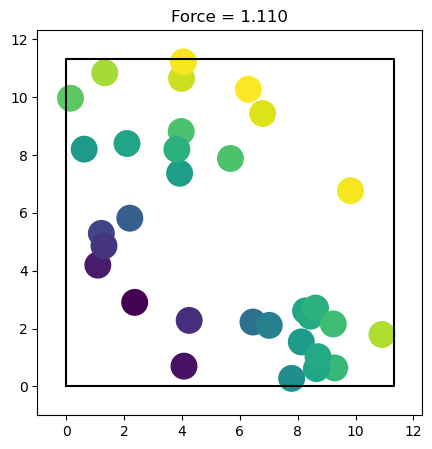

In [11]:
makemovie_2d(R[None, : , : ], sigma = np.ones(N), colorby = np.linalg.norm(grad(np.linalg.norm)(R), axis =1), xylims=box_size, box_trajectory= box_size, stride = 10, TitleString="Force = ", TitleList=max_force, Decimals = 3)

# Minimization

In [7]:

init_fn, apply_fn = minimize.fire_descent(energy_fn, shift)
force_tol = 1e-4

state = init_fn(R)

cond_fn = lambda state: np.max(np.abs(state.force)) > force_tol
def minimize_config(R):
  init_fn, apply_fn = minimize.fire_descent(energy_fn, shift)

  state = init_fn(R)
  # Using a JAX loop reduces compilation cost
  state = while_loop(cond_fun=cond_fn,
                     body_fun=apply_fn,
                     init_val=state)

  return state.position

minimize_config = jit(minimize_config) #jit it

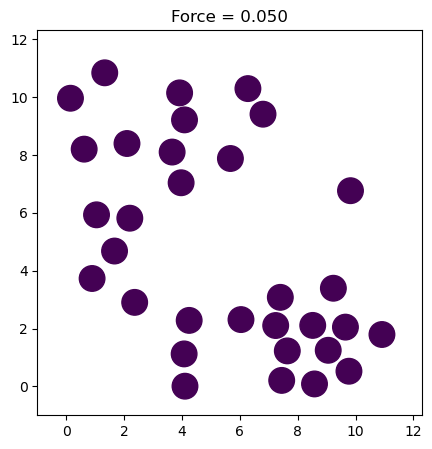

In [8]:
state = init_fn(R)
trajectory = []
max_force = []

while np.max(np.abs(state.force)) > force_tol:
  state = apply_fn(state)
  trajectory += [state.position]
  max_force += [np.max(np.abs(state.force))]
  #print(np.max(np.abs(state.force)))
trajectory = np.stack(trajectory)
R_is = minimize_config(R)
makemovie_2d(trajectory, sigma = np.ones(N), colorby = np.ones(N), xylims=box_size, stride = 10, TitleString="Force = ", TitleList=max_force, Decimals = 3)

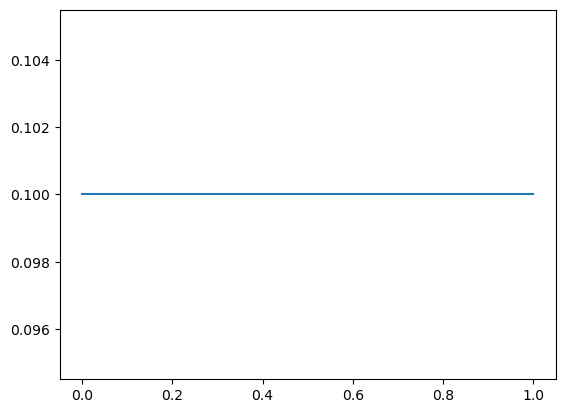

In [167]:
dt = 0.01
steps = 100
T_init = 0.1
t = onp.arange(0, steps) * dt
kT = lambda t: np.ones_like(t)*T_init
plt.plot(np.linspace(0, steps*dt, 100), kT(np.linspace(0, steps*dt, 100)))
# temeprature setpoints

you could also prescribe steps

In [251]:
energy_fn = energy.soft_sphere_pair(displacement, sigma = 1, epsilon = 1)
init, apply = simulate.nve(energy_fn, shift, dt)
state = init(key, trajectory_init[-1], kT = kT(0.))

In [252]:


write_every = 5

def step_fn(i, state_and_log):
  state, log = state_and_log

  t = i * dt

  # Log information about the simulation.
  T = quantity.temperature(momentum=state.momentum)

  log['kT'] = log['kT'].at[i].set(T)

  # Record positions every `write_every` steps.
  log['position'] = lax.cond(i % write_every == 0,
                             lambda p: \
                             p.at[i // write_every].set(state.position),
                             lambda p: p,
                             log['position'])
  log['velocity'] = lax.cond(i % write_every == 0,
                             lambda p: \
                             p.at[i // write_every].set(state.velocity),
                             lambda p: p,
                             log['velocity'])
  # Take a simulation step.
  state = apply(state)

  return state, log

In [253]:


step_fn = jit(step_fn)

log = {
    'kT': np.zeros((steps,)),
    'position': np.zeros((steps // write_every,) + R.shape),
    'velocity': np.zeros((steps // write_every,) + R.shape)
}

state, log = lax.fori_loop(0, steps, step_fn, (state, log))



# visuals

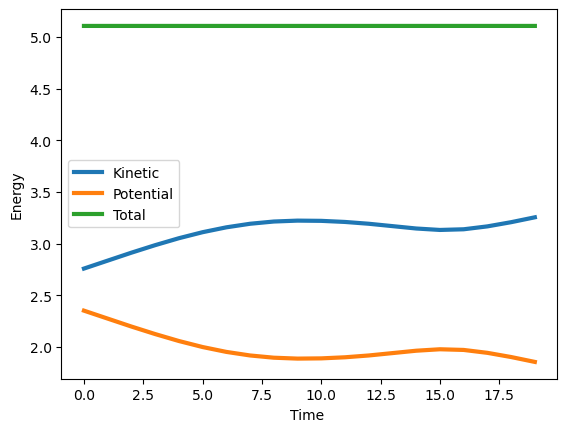

In [254]:
KE = vmap(quantity.kinetic_energy)(velocity =log['velocity'])
PE = vmap(energy_fn)(log['position'])


plt.plot(KE, linewidth=3)
plt.plot(PE, linewidth=3)
plt.plot(np.array(KE)+np.array(PE), linewidth=3)
plt.xlabel('Time ')
plt.ylabel('Energy')
plt.legend(['Kinetic', 'Potential', 'Total'])

Text(0, 0.5, 'Temperature')

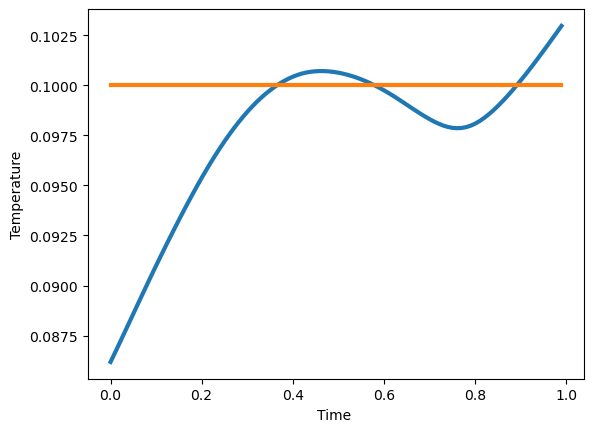

In [255]:
t = onp.arange(0, steps) * dt
plt.plot(t, log['kT'], linewidth=3)
plt.plot(t, kT(t), linewidth=3)
plt.xlabel('Time ')
plt.ylabel('Temperature')


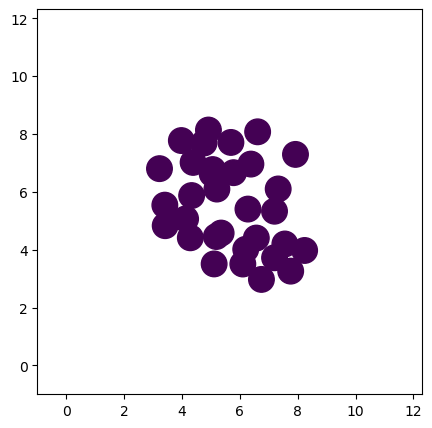

In [256]:
makemovie_2d(log['position'], sigma = np.ones(N), colorby = np.ones(N), xylims=(box_size), stride = 1)

# Differentiating a Simulation (velocity)

In [267]:
def minimal_simulation_v(pos, vel):
    state_init = init(key, pos, kT(0.))
    state_init.set( momentum = vel)
    @jit
    def minimal_step_fn(i, state):
        t = i * dt
        return apply(state)

    state_final = lax.fori_loop(0, steps, minimal_step_fn, state_init)
    return state_final

In [268]:
state_final = minimal_simulation_v(R_is, temp_v)

In [271]:
def objective_fn_v(pos, vel):
    state_init = init(key, pos, kT(0.))
    state_init.set( momentum = vel)
    @jit
    def minimal_step_fn(i, state):
        t = i * dt
        return apply(state)

    state_final = lax.fori_loop(0, steps, minimal_step_fn, state_init)
    return np.linalg.norm(state_final.position - box_size/2)

In [276]:
grad_fn = jit(grad(objective_fn_v, 0))

In [277]:
grad_fn(R_is,temp_v)

Array([[-0.17449437, -0.06059017],
       [-0.20535652,  0.10711264],
       [ 0.16003351, -0.18809843],
       [-0.00124579,  0.09407727],
       [-0.04147499, -0.16922657],
       [-0.07329294,  0.1749663 ],
       [-0.17200949, -0.0087285 ],
       [ 0.06717821, -0.06864702],
       [-0.01221169, -0.10944572],
       [-0.0350719 , -0.1221826 ],
       [ 0.11537545, -0.2013646 ],
       [-0.12439494, -0.10199518],
       [ 0.01877172,  0.18135554],
       [ 0.07446971,  0.20803856],
       [ 0.15042443,  0.03924623],
       [ 0.05397757, -0.1524255 ],
       [-0.14895986,  0.1874704 ],
       [ 0.09132357, -0.13369253],
       [ 0.13535345, -0.15865012],
       [ 0.20384368,  0.14682192],
       [-0.13420021,  0.0129961 ],
       [-0.07202379,  0.19133159],
       [ 0.03576437,  0.13126741],
       [-0.05239263,  0.10146074],
       [-0.058162  ,  0.06442827],
       [ 0.13118131, -0.07292509],
       [ 0.06912883, -0.13743711],
       [-0.11089815,  0.10027171],
       [-0.05619724,

In [257]:
temp_v = state.velocity

In [249]:
opt_steps = 100
trajectory_init = np.zeros((opt_steps, N, 2))
trajectory_final = np.zeros((opt_steps, N, 2))
#R_current = R_is
for i in range(opt_steps):
    trajectory_init = trajectory_init.at[i].set(R_current)
    gradients = grad_fn(R_current)
    R_new = shift(R_current, - 0.01*gradients/np.max(np.linalg.norm(gradients, axis = 1)))
    trajectory_final = trajectory_final.at[i].set(minimal_simulation(R_new).position)
    R_current = R_new
    print(objective_fn(R_current))


15.266980573845629
15.230032673099943
15.193102632453703
15.156188363836971
15.119290022952326
15.082408558653572
15.045552217419822
15.008722631358385
14.97192027492453
14.935142856864799
14.898390240061257
14.861657151338262
14.824952234480595
14.788265475117923
14.75159888245373
14.714952436359665
14.67832667872302
14.641721331538431
14.605133929050918
14.568561908317697
14.532007878696374
14.495471996772936
14.458951734221355
14.42244583466234
14.385955137046874
14.34947950579191
14.313017108775153
14.276568403849948
14.240136042549164
14.203723662883574
14.167322742554925
14.130942470315313
14.094573016950925
14.058219426370673
14.021875859913859
13.985548049360233
13.94925328903652
13.913011783347285
13.87682762165474
13.840689246310175
13.804596997759292
13.768541762488253
13.732524714930825
13.696533942076258
13.660565175109811
13.624617647381363
13.588687887485769
13.552773349525692
13.51687158887858
13.480983678544057
13.445102713347197
13.40923793504579
13.373385571302276
13

In [229]:
grad_fn(R_is)

Array([[-4.62986439e-03,  4.67844053e-01],
       [-1.03115917e-01,  2.37291768e-01],
       [ 1.26406011e+00,  3.19984927e-01],
       [ 2.69062107e-01,  7.67742448e-02],
       [ 9.66281173e-02,  3.30008551e-01],
       [ 2.34591302e-01, -4.00609761e-01],
       [ 2.06074084e-01, -8.00220935e-02],
       [-4.50599768e-01, -9.50434898e-01],
       [ 8.19822935e-02,  1.29935755e-01],
       [ 5.05507417e-02,  8.76083096e-02],
       [-3.69042540e-01,  1.91831877e-01],
       [ 4.04413058e-01, -2.39750928e-02],
       [-8.83003588e-01,  2.03676868e+00],
       [ 1.82256696e-01,  1.40773114e+00],
       [ 1.86977073e-01,  7.81698652e-02],
       [-5.91569225e-01, -5.38148095e-01],
       [ 1.93535885e-01,  1.23769464e-01],
       [ 4.78253931e-01,  2.56565247e-01],
       [ 5.61053036e-01,  1.70593278e+00],
       [-1.02856613e-03, -6.96498833e-02],
       [-3.44792973e-02,  1.68762256e-01],
       [ 2.01664119e-01, -1.22002956e-01],
       [ 1.19830803e+00, -1.74556729e+00],
       [-8.

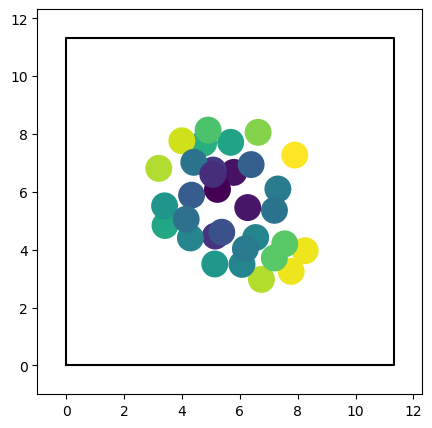

In [250]:
makemovie_2d(trajectory_final, sigma = np.ones(N), colorby = np.linalg.norm(grad_fn(R_is), axis = 1), xylims=box_size, box_trajectory= box_size, stride = 1)

# Multiple Species

## Setup

JAX MD has inbuilt functions that take in sigma matrices for species sigma_ij!

In [10]:
# The system ought to be a 50:50 mixture of two types of particles, one
# large and one small.

sigma_species = np.array([1.0, 1.0])
epsilon_species = np.array([1.0, 1.0])

sigma = 0.5 * (sigma_species[None,:] + sigma_species[:,None])
epsilon= (epsilon_species[None,:] * epsilon_species[:,None])**(0.5)
epsilon = epsilon.at[1,0].set(0.1)
epsilon = epsilon.at[0,1].set(0.1)
N_2 = int(N / 2)
species = np.where(np.arange(N) < N_2, 0, 1)
energy_fn = energy.lennard_jones_pair(displacement, species=species, sigma=sigma, epsilon=epsilon)




Redefine the step function to contain the new energy function! We use the same initial condition for big spheres, knowing that we only made half of them smaller.

In [11]:


init, apply = simulate.nvt_nose_hoover(energy_fn, shift, dt, kT(0.), tau = dt*100)
state = init(key, R_is)


write_every = 50

#

def step_fn(i, state_and_log):
  state, log = state_and_log

  t = i * dt

  # Log information about the simulation.
  T = quantity.temperature(momentum=state.momentum)

  log['kT'] = log['kT'].at[i].set(T)

  H = simulate.nvt_nose_hoover_invariant(energy_fn, state, kT(t))
  log['H'] = log['H'].at[i].set(H)

  # Record positions every `write_every` steps.
  log['position'] = lax.cond(i % write_every == 0,
                             lambda p: \
                             p.at[i // write_every].set(state.position),
                             lambda p: p,
                             log['position'])

  # Take a simulation step.
  state = apply(state, kT=kT(t))

  return state, log


log = {
    'kT': np.zeros((steps,)),
    'H': np.zeros((steps,)),
    'position': np.zeros((steps // write_every,) + R.shape)
}


state, log = lax.fori_loop(0, steps, step_fn, (state, log))

NameError: name 'dt' is not defined

Text(0, 0.5, 'Temperature')

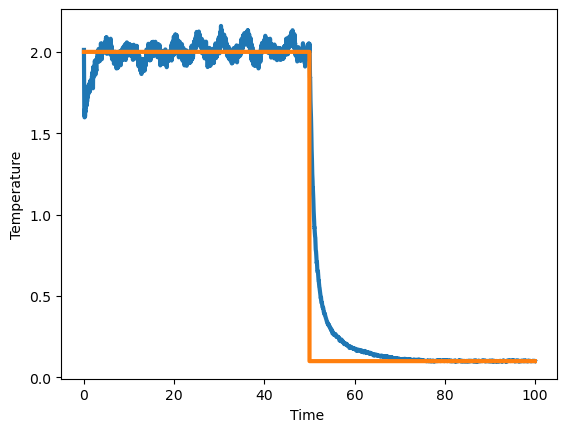

In [166]:
t = onp.arange(0, steps) * dt
plt.plot(t, log['kT'], linewidth=3)
plt.plot(t, kT(t), linewidth=3)
plt.xlabel('Time ')
plt.ylabel('Temperature')

In [167]:
epsilon_list = epsilon_species[species]
sigma_list = sigma_species[species]

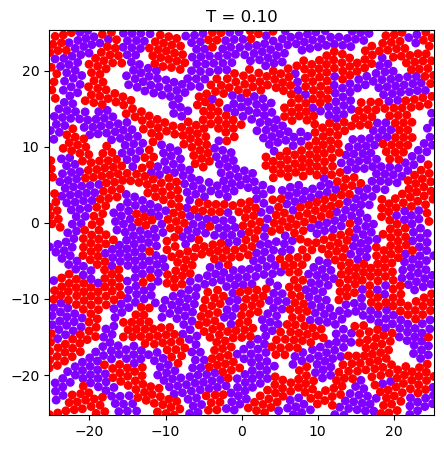

In [171]:
makemovie_2d(wrap(log['position'], box_length=box_size), sigma = sigma_list, colorby = species, xylims=box_size/2, stride = 3,  TitleList=kT(t)[0:-1:write_every], TitleString="T = ")

# Physical Properties

In [ ]:
displacement, shift = space.periodic(box_size)

In [ ]:
from jax_md import energy

soft_sphere = energy.soft_sphere_pair(displacement, alpha=2)

In [ ]:
from jax_md import quantity

quantity.pressure(soft_sphere, R_is, box_size)

Array(0.04558352, dtype=float64, weak_type=True)

In [ ]:
quantity.stress(soft_sphere, R_is, box_size)

Array([[0.04870601, 0.00813744],
       [0.00813744, 0.04246104]], dtype=float64)

In [ ]:
from jax_md import elasticity
moduli_fn = elasticity.athermal_moduli(soft_sphere, tether_strength=1e-4)

In [ ]:
elastic_constants = moduli_fn(R_is, box_size)

In [ ]:
quantity.bulk_modulus(elastic_constants)